# Police Fatalities in the US From 2000 To 2020

Data obtained from Kaggle: https://www.kaggle.com/datasets/djonafegnem/police-fatalities-in-the-us-from-2000-to-2020

GitHub link: https://github.com/samantharivas/Police_Fatalities.git

## Import Libaries

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns

import dmba
from dmba import regressionSummary, gainsChart, liftChart
from dmba import adjusted_r2_score, AIC_score, BIC_score

from sklearn.impute import SimpleImputer
from sklearn.impute import KNNImputer
from sklearn.metrics import confusion_matrix, accuracy_score, ConfusionMatrixDisplay, classification_report
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.preprocessing import OneHotEncoder

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_selection import SelectKBest, chi2, f_classif
from sklearn.linear_model import Perceptron

import scipy.stats as stats
from scipy.stats import chi2_contingency

import folium


import os

%matplotlib inline
import matplotlib.pylab as plt
import matplotlib 
import matplotlib.ticker as mticker

import warnings
warnings.filterwarnings("ignore") #supress warnings

no display found. Using non-interactive Agg backend


## Import Dataset

In [2]:
# download datset from Kaggle
police_df = pd.read_csv('police_fatalities.csv') # read csv file 

# rename columns by replacing spaces with underscores
police_df.columns = police_df.columns.str.replace(' ', '_')

# replace single quotes with an empty string in column names
police_df.columns = police_df.columns.str.replace("'", "")

In [3]:
# print 10 random samples from the dataframe 
police_df.sample(10)

,Unique_ID,Subjects_name,Subjects_age,Subjects_gender,Subjects_race,Subjects_race_with_imputations,Imputation_probability,URL_of_image_of_deceased,Date_of_injury_resulting_in_death_(month/day/year),Location_of_injury_(address),...,A_brief_description_of_the_circumstances_surrounding_the_death,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Intentional_Use_of_Force_(Developing),Link_to_news_article_or_photo_of_official_document,"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Video,Date&Description,Unique_ID_formula,Unique_identifier_(redundant),Date_(Year)
11040,19212,Jason Kastelhun,28,Male,European-American/White,European-American/White,not imputed,https://www.fatalencounters.org/wp-content/upl...,01/09/2010,179 Grapevine Road,...,Deputy Andy Martin shot and killed a drunk and...,Justified,"Intentional Use of Force, Deadly",http://www.postandcourier.com/article/20100112...,Yes,NaN,1/9/2010: Deputy Andy Martin shot and killed a...,NaN,19212.0,2010.0
10349,20414,Tony Anderson,55,Male,Race unspecified,African-American/Black,0.96572874,NaN,06/24/2009,4223 Otter St.,...,Tony Anderson was shot and killed by police as...,Unreported,"Intentional Use of Force, Deadly",https://docs.google.com/document/d/1YNjdCLfjYQ...,No,NaN,6/24/2009: Tony Anderson was shot and killed b...,NaN,20414.0,2009.0
12196,9673,Joe Weible,35,Male,European-American/White,European-American/White,not imputed,https://fatalencounters.org/wp-content/uploads...,12/06/2010,W Center Rd & S 120th St,...,"Police revealed Weible did not have a gun, but...",Grand jury/No bill or Cleared,"Intentional Use of Force, Deadly",http://www.wowt.com/home/headlines/Fugitive_Sh...,No,NaN,12/6/2010: Police revealed Weible did not have...,NaN,9673.0,2010.0
10373,8228,Stacey Tyrone Paris,NaN,Male,African-American/Black,African-American/Black,not imputed,NaN,06/29/2009,5327 S Lamar St,...,Security guards at Borden Dairy detained Paris...,Unreported,Yes,https://archive.org/stream/pdfy-SYlQJPEJeyuTNI...,Unknown,NaN,6/29/2009: Security guards at Borden Dairy det...,NaN,8228.0,2009.0
17447,14346,Rolando Haro-Villanueva,24,Male,Hispanic/Latino,Hispanic/Latino,not imputed,http://media.kimatv.com/images/rolando+1.jpg,04/12/2014,I-82 and Knob Hill Boulevard,...,Police pulled Villanueva over for allegedly dr...,Pending investigation,"Intentional Use of Force, Deadly",http://www.yakimaherald.com/home/2101128-8/yak...,Unknown,NaN,4/12/2014: Police pulled Villanueva over for a...,NaN,14346.0,2014.0
24016,23897,Jennifer Gonzales Shushereba,32,Female,European-American/White,European-American/White,not imputed,https://www.fatalencounters.org/wp-content/upl...,03/09/2018,260 California Dr,...,"Albert Wong, a man armed with a rifle, alleged...",Murder/suicide,"Intentional Use of Force, Deadly",http://napavalleyregister.com/news/local/man-w...,Yes,NaN,"3/9/2018: Albert Wong, a man armed with a rifl...",NaN,23897.0,2018.0
24699,24522,Wesley Shelton,33,Male,European-American/White,European-American/White,not imputed,https://www.fatalencounters.org/wp-content/upl...,07/18/2018,3450 Hendersonville Rd,...,Officers were dispatched to a CVS pharmacy at ...,Pending investigation,"Intentional Use of Force, Deadly",http://www.blueridgenow.com/news/20180718/upda...,No,NaN,7/18/2018: Officers were dispatched to a CVS p...,NaN,24522.0,2018.0
27302,27233,Frederick Jeremy Atkin,42,Male,European-American/White,European-American/White,not imputed,https://fatalencounters.org/wp-content/uploads...,12/27/2019,Wall Ave and Riverdale Rd,...,Police were pursuing a red Mustang about 1 a.m...,Pending investigation,"Intentional Use of Force, Deadly",https://www.ksl.com/article/46695984/1-dead-fo...,Drug or alcohol use,NaN,12/27/2019: Police were pursuing a red Mustang...,NaN,27233.0,2019.0
6763,5373,Michael Moore,33,Male,African-American/Black,African-American/Black,not imputed,https://fatalencounters.org/wp-content/uploads...,08/09/2006,Bryan Street and Highway 301,...,Traffic stop gone wrong,Unreported,"Int

## Data Inspection

In [4]:
police_df.shape

(28335, 29)

In [5]:
police_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28335 entries, 0 to 28334
Data columns (total 29 columns):
 #   Column                                                          Non-Null Count  Dtype  
---  ------                                                          --------------  -----  
 0   Unique_ID                                                       28334 non-null  object 
 1   Subjects_name                                                   28335 non-null  object 
 2   Subjects_age                                                    27354 non-null  object 
 3   Subjects_gender                                                 28237 non-null  object 
 4   Subjects_race                                                   28334 non-null  object 
 5   Subjects_race_with_imputations                                  27905 non-null  object 
 6   Imputation_probability                                          27897 non-null  object 
 7   URL_of_image_of_deceased                         

In [6]:
# convert coolumns which contain numerical values into numeric data type 

columns_to_convert = ['Subjects_age', 'Latitude', 'Longitude','Location_of_death_(zip_code)', 
                      'Imputation_probability','Unique_identifier_(redundant)', 'Date_(Year)']

for col in columns_to_convert:
    police_df[col] = pd.to_numeric(police_df[col], errors='coerce')
    
police_df.info() #check data type after conversion 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28335 entries, 0 to 28334
Data columns (total 29 columns):
 #   Column                                                          Non-Null Count  Dtype  
---  ------                                                          --------------  -----  
 0   Unique_ID                                                       28334 non-null  object 
 1   Subjects_name                                                   28335 non-null  object 
 2   Subjects_age                                                    27294 non-null  float64
 3   Subjects_gender                                                 28237 non-null  object 
 4   Subjects_race                                                   28334 non-null  object 
 5   Subjects_race_with_imputations                                  27905 non-null  object 
 6   Imputation_probability                                          7029 non-null   float64
 7   URL_of_image_of_deceased                         

In [7]:
# convert the date column to a datetime format
police_df['Date_of_injury_resulting_in_death'] = pd.to_datetime(police_df['Date_of_injury_resulting_in_death_(month/day/year)'])

# extract month, day, and year into separate columns
police_df['Injury_Month'] = police_df['Date_of_injury_resulting_in_death'].dt.month
police_df['Injury_Day'] = police_df['Date_of_injury_resulting_in_death'].dt.day
police_df['Injury_Year'] = police_df['Date_of_injury_resulting_in_death'].dt.year

police_df.sample(10)

,Unique_ID,Subjects_name,Subjects_age,Subjects_gender,Subjects_race,Subjects_race_with_imputations,Imputation_probability,URL_of_image_of_deceased,Date_of_injury_resulting_in_death_(month/day/year),Location_of_injury_(address),...,"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Video,Date&Description,Unique_ID_formula,Unique_identifier_(redundant),Date_(Year),Date_of_injury_resulting_in_death,Injury_Month,Injury_Day,Injury_Year
618,471,Dwight Jones,45.0,Male,Race unspecified,European-American/White,0.583381,NaN,09/18/2000,Tassajara Road,...,Unknown,NaN,9/18/2000: Limousine driver Dwight Jones was k...,NaN,471.0,2000.0,2000-09-18,9,18,2000
9598,7634,Mark Brooks Lee,42.0,Male,Race unspecified,European-American/White,0.598913,NaN,11/14/2008,6130 Corson Ave.,...,No,NaN,11/14/2008: Local police responding to a domes...,NaN,7634.0,2008.0,2008-11-14,11,14,2008
574,433,Courtney Mathis,12.0,Male,African-American/Black,African-American/Black,NaN,http://www.enquirer.com/editions/2001/04/15/ma...,09/01/2000,Colerain Avenue and North Bend Road,...,No,NaN,9/1/2000: Mathis stole a car and when an offic...,NaN,433.0,2000.0,2000-09-01,9,1,2000
21544,18287,Dylan Rogers,39.0,Male,Native American/Alaskan,Native American/Alaskan,NaN,https://www.fatalencounters.org/wp-content/upl...,10/08/2016,E 127 Rd and N S 381 Rd,...,No,NaN,10/8/2016: Police began a chase after a vehicl...,NaN,18287.0,2016.0,2016-10-08,10,8,2016
10647,8449,Christopher Reynoso,31.0,Male,European-American/White,European-American/White,NaN,NaN,09/20/2009,3875 S. San Pablo Rd,...,No,NaN,9/20/2009: Heavily armed Navy veteran marksman...,NaN,8449.0,2009.0,2009-09-20,9,20,2009
25,22243,Nancy Smith,35.0,Female,Race unspecified,European-American/White,0.904964,NaN,01/08/2000,2800 block Kings Creek Road,...,No,NaN,1/8/2000: State police were called to assist t...,NaN,22243.0,2000.0,2000-01-08,1,8,2000
16541,13468,Weston Tanner,21.0,Male,European-American/White,European-American/White,NaN,NaN,09/27/2013,16711 Marsh Creek Road,...,No,NaN,"9/27/2013: Tanner died in a vehicle crash, aft...",NaN,13468.0,2013.0,2013-09-27,9,27,2013
26537,27509,"Daniel ""Bunk"" Edward Phillips",42.0,Male,European-American/White,European-American/White,NaN,https://fatalencounters.org/wp-content/uploads...,07/24/2019,Lake Hawkins,...,No,NaN,"7/24/2019: Around 1 a.m., deputies approached ...",NaN,27509.0,2019.0,2019-07-24,7,24,2019
25018,24874,Johnny Lee Lloyd,53.0,Male,African-American/Black,African-American/Black,NaN,https://www.fatalencounters.org/wp-content/upl...,09/14/2018,250 W Old Dover Rd,...,No,NaN,"9/14/2018: According to police, officers were ...",NaN,24874.0,2018.0,2018-09-14,9,14,2018
6828,23057,Marcus A. Watkins Sr.,24.0,Male,African-American/Black,African-American/Black,NaN,https://fatalencounters.org/wp-content/uploads...,08/28/2006,1160 Eastmoreland Ave,...,Drug or alcohol use,NaN,8/28/2006: Marcus Watkins was fatally shot whe...,NaN,23057.0,2006.0,2006-08-28,8,28,2006


In [8]:
police_df.columns #column names within the df 

Index(['Unique_ID', 'Subjects_name', 'Subjects_age', 'Subjects_gender',
       'Subjects_race', 'Subjects_race_with_imputations',
       'Imputation_probability', 'URL_of_image_of_deceased',
       'Date_of_injury_resulting_in_death_(month/day/year)',
       'Location_of_injury_(address)', 'Location_of_death_(city)',
       'Location_of_death_(state)', 'Location_of_death_(zip_code)',
       'Location_of_death_(county)', 'Full_Address', 'Latitude', 'Longitude',
       'Agency_responsible_for_death', 'Cause_of_death',
       'A_brief_description_of_the_circumstances_surrounding_the_death',
       'Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS',
       'Intentional_Use_of_Force_(Developing)',
       'Link_to_news_article_or_photo_of_official_document',
       'Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS', 'Video',
       'Date&Description', 'Unique_ID_formula',
       'Unique_identifier_(redundant)', 'Date_(Year)',
       'Date_of_injury_resulting_in_death', 'Injur

In [9]:
police_df.nunique() #number of unique values within each column 

Unique_ID                                                         28334
Subjects_name                                                     26982
Subjects_age                                                         97
Subjects_gender                                                       3
Subjects_race                                                         8
Subjects_race_with_imputations                                        9
Imputation_probability                                             6954
URL_of_image_of_deceased                                          12857
Date_of_injury_resulting_in_death_(month/day/year)                 7182
Location_of_injury_(address)                                      26026
Location_of_death_(city)                                           5940
Location_of_death_(state)                                            51
Location_of_death_(zip_code)                                      10460
Location_of_death_(county)                                      

In [10]:
police_df.kurtosis() # shape of distribution of numeric columns 

Subjects_age                     0.528233
Imputation_probability           0.079034
Location_of_death_(zip_code)    -1.272116
Latitude                         1.737740
Longitude                       -0.157605
Unique_ID_formula                     NaN
Unique_identifier_(redundant)   -1.200000
Date_(Year)                      0.842675
Injury_Month                    -1.167422
Injury_Day                      -1.192541
Injury_Year                      0.836232
dtype: float64

## Exploratory Data Analysis

### Handling Missing Data 

In [11]:
#identify missing values in each column 
police_df.isnull().sum()  

Unique_ID                                                             1
Subjects_name                                                         0
Subjects_age                                                       1041
Subjects_gender                                                      98
Subjects_race                                                         1
Subjects_race_with_imputations                                      430
Imputation_probability                                            21306
URL_of_image_of_deceased                                          15424
Date_of_injury_resulting_in_death_(month/day/year)                    0
Location_of_injury_(address)                                        542
Location_of_death_(city)                                             36
Location_of_death_(state)                                             1
Location_of_death_(zip_code)                                        190
Location_of_death_(county)                                      

In [12]:
# calculate missing values as a percentage of total data 
missing_percentage = (police_df.isnull().sum() / len(police_df)) * 100
missing_percentage = missing_percentage.sort_values(ascending=False)

print('Missing Value Percentage per Column:')
print(missing_percentage)

Missing Value Percentage per Column:
Unique_ID_formula                                                 99.992942
Video                                                             99.989412
Imputation_probability                                            75.193224
URL_of_image_of_deceased                                          54.434445
Subjects_age                                                       3.673902
Location_of_injury_(address)                                       1.912829
Subjects_race_with_imputations                                     1.517558
Location_of_death_(zip_code)                                       0.670549
Subjects_gender                                                    0.345862
Agency_responsible_for_death                                       0.243515
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS         0.218811
Location_of_death_(city)                                           0.127051
Date&Description                                   

The columns which have a majority of their rows missing (50% and above), to maintain the integrity of the data, they will be dropped instead of imputed.

In [13]:
# drop columns where more than 50% of the data is missing 

# identify columns with more than 50% missing values
columns = missing_percentage[missing_percentage > 50]
columns_to_drop = missing_percentage[missing_percentage > 50].index

print('Columns with More than 50% Missing Values:')
print(columns)

Columns with More than 50% Missing Values:
Unique_ID_formula           99.992942
Video                       99.989412
Imputation_probability      75.193224
URL_of_image_of_deceased    54.434445
dtype: float64


In [14]:
# drop the identified columns from the DataFrame
police_df.drop(columns=columns_to_drop, inplace=True)

Remaining of the missing values will be filled with the 'most frequent' value using a SimpleImputer.

In [15]:
# use SimpleImputer to replace the NaN values with the 'most frequent value '
imp = SimpleImputer(strategy = 'most_frequent')

In [16]:
# fit and transform the data replacing the NaN values of each feature with the
# 'most frequent' value of each feature
imputed_df = imp.fit_transform(police_df)

In [17]:
# obtain column names from original df
column_names = police_df.columns

# create a df from the imputed_data array
imputed_df = pd.DataFrame(imputed_df, columns=column_names)

imputed_df.head()

,Unique_ID,Subjects_name,Subjects_age,Subjects_gender,Subjects_race,Subjects_race_with_imputations,Date_of_injury_resulting_in_death_(month/day/year),Location_of_injury_(address),Location_of_death_(city),Location_of_death_(state),...,Intentional_Use_of_Force_(Developing),Link_to_news_article_or_photo_of_official_document,"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Date&Description,Unique_identifier_(redundant),Date_(Year),Date_of_injury_resulting_in_death,Injury_Month,Injury_Day,Injury_Year
0,25746,Samuel H. Knapp,17.0,Male,European-American/White,European-American/White,01/01/2000,27898-27804 US-101,Willits,CA,...,Vehicle/Pursuit,https://drive.google.com/file/d/10DisrV8K5ReP1...,No,1/1/2000: Samuel Knapp was allegedly driving a...,25746.0,2000.0,2000-01-01,1,1,2000
1,25747,Mark A. Horton,21.0,Male,African-American/Black,African-American/Black,01/01/2000,Davison Freeway,Detroit,MI,...,Vehicle/Pursuit,https://drive.google.com/file/d/1-nK-RohgiM-tZ...,No,1/1/2000: Two Detroit men killed when their ca...,25747.0,2000.0,2000-01-01,1,1,2000
2,25748,Phillip A. Blurbridge,19.0,Male,African-American/Black,African-American/Black,01/01/2000,Davison Freeway,Detroit,MI,...,Vehicle/Pursuit,https://drive.google.com/file/d/1-nK-RohgiM-tZ...,No,1/1/2000: Two Detroit men killed when their ca...,25748.0,2000.0,2000-01-01,1,1,2000
3,25749,Mark Ortiz,23.0,Male,Hispanic/Latino,Hispanic/Latino,01/01/2000,600 W Cherry Ln,Carlsbad,NM,...,Vehicle/Pursuit,https://drive.google.com/file/d/1qAEefRjX_aTtC...,No,1/1/2000: A motorcycle was allegedly being dri...,25749.0,2000.0,2000-01-01,1,1,2000
4,2,Lester Miller,53.0,Male,Race unspecified,African-American/Black,01/02/2000,4850 Flakes Mill Road,Ellenwood,GA,...,"Intentional Use of Force, Deadly",https://docs.google.com/document/d/1-YuShSarW_...,No,"1/2/2000: Darren Mayfield, a DeKalb County she...",2.0,2000.0,2000-01-02,1,2,2000


### Removing Duplicate Values

In [18]:
# identify number of duplicates in the df  
duplicates = imputed_df.duplicated()

# display rows with duplicates
duplicates = imputed_df.duplicated()
count_duplicates = duplicates.sum()
print("Count of Duplicate Rows:", count_duplicates)

Count of Duplicate Rows: 0


Data frame has zero duplicate values, thus all values remain. 

### Dropping Columns 

In [19]:
# drop redudant columns that will not be used for modeling 

imputed_df.drop(columns=['Unique_identifier_(redundant)', 'Link_to_news_article_or_photo_of_official_document', 
                        'Subjects_race_with_imputations', 'Subjects_name', 'Date&Description', 
                        'Full_Address', 'Date_(Year)', 'Date_of_injury_resulting_in_death', 'Injury_Day', 
                        'Date_of_injury_resulting_in_death_(month/day/year)'],inplace=True)

imputed_df.head()

,Unique_ID,Subjects_age,Subjects_gender,Subjects_race,Location_of_injury_(address),Location_of_death_(city),Location_of_death_(state),Location_of_death_(zip_code),Location_of_death_(county),Latitude,Longitude,Agency_responsible_for_death,Cause_of_death,A_brief_description_of_the_circumstances_surrounding_the_death,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Intentional_Use_of_Force_(Developing),"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Injury_Month,Injury_Year
0,25746,17.0,Male,European-American/White,27898-27804 US-101,Willits,CA,95490.0,Mendocino,39.470883,-123.361751,Mendocino County Sheriff's Office,Vehicle,Samuel Knapp was allegedly driving a stolen ve...,Unreported,Vehicle/Pursuit,No,1,2000
1,25747,21.0,Male,African-American/Black,Davison Freeway,Detroit,MI,48203.0,Wayne,42.404526,-83.092274,Los Angeles Police Department,Vehicle,Two Detroit men killed when their car crashed ...,Unreported,Vehicle/Pursuit,No,1,2000
2,25748,19.0,Male,African-American/Black,Davison Freeway,Detroit,MI,48203.0,Wayne,42.404526,-83.092274,Los Angeles Police Department,Vehicle,Two Detroit men killed when their car crashed ...,Unreported,Vehicle/Pursuit,No,1,2000
3,25749,23.0,Male,Hispanic/Latino,600 W Cherry Ln,Carlsbad,NM,88220.0,Eddy,32.45008,-104.237643,Eddy County Sheriff's Office,Vehicle,A motorcycle was allegedly being driven errati...,Unreported,Vehicle/Pursuit,No,1,2000
4,2,53.0,Male,Race unspecified,4850 Flakes Mill Road,Ellenwood,GA,30294.0,DeKalb,33.645164,-84.229413,DeKalb County Sheriff's Office,Gunshot,"Darren Mayfield, a DeKalb County sheriff's dep...",Criminal,"Intentional Use of Force, Deadly",No,1,2000


## Data Visualizations


#### Map Visualizations - Subset Dataset to California 

In [20]:
# create United States map with incidents based on longitude and latitude values - sorted by gender 

# calculate the average latitude and longitude values 
average_latitude = imputed_df['Latitude'].mean()
average_longitude = imputed_df['Longitude'].mean()

# use the average coordinates as the center
latitude_center = average_latitude
longitude_center = average_longitude


us_map = folium.Map(location=[latitude_center, longitude_center], zoom_start=3)

# add markers for each location using latitude and longitude based on identified gender 
for index, row in imputed_df.iterrows():
    gender = row["Subjects_gender"]
    color = 'blue' if gender == 'Male' else 'red' if gender == 'Female' else 'gray' 

    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,  
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        tooltip=f"Gender: {gender}"
    ).add_to(us_map)

# display map
us_map

In [21]:
# create subset for California data 
ca_df = imputed_df[imputed_df['Location_of_death_(state)'] == 'CA']

#drop location by state and zip code
ca_df = ca_df.drop(columns=['Location_of_death_(state)', 'Location_of_death_(zip_code)'])

ca_df.sample(10)

,Unique_ID,Subjects_age,Subjects_gender,Subjects_race,Location_of_injury_(address),Location_of_death_(city),Location_of_death_(county),Latitude,Longitude,Agency_responsible_for_death,Cause_of_death,A_brief_description_of_the_circumstances_surrounding_the_death,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Intentional_Use_of_Force_(Developing),"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Injury_Month,Injury_Year
1902,1499,50.0,Female,Race unspecified,I-680 and CA-242,Concord,Contra Costa,37.95417,-122.054345,California Highway Patrol,Vehicle,Sharon SiddalL was killed when her car was str...,Unknown,Vehicle/Pursuit,No,2,2002
20601,17371,28.0,Male,Hispanic/Latino,El Dorado Street and Clay Street,Stockton,San Joaquin,37.939868,-121.286277,Stockton Police Department,Asphyxiated/Restrained,Cordova-Cuevas was pulled over at El Dorado an...,Pending investigation,Yes,No,3,2016
10142,8050,22.0,Male,Race unspecified,22415 North Fifth Avenue,Castro Valley,Alameda,37.681329,-122.076356,Alameda County Sheriff's Office,Gunshot,Deputies shot an unnamed man when he allegedly...,Unreported,"Intentional Use of Force, Deadly",Unknown,4,2009
24446,24262,38.0,Male,Hispanic/Latino,20040 Hawthorne Blvd,Torrance,Los Angeles,33.84989,-118.35155,Torrance Police Department,Gunshot,"Around 8:45 a.m., police were dispatched to th...",Pending investigation,"Intentional Use of Force, Deadly",No,6,2018
874,674,29.0,Male,African-American/Black,90th Avenue and B Street,Oakland,Alameda,37.750611,-122.172195,Oakland Police Department,Gunshot,Two rookie Oakland patrolmen shot and killed a...,Unknown,"Intentional Use of Force, Deadly",No,1,2001
25087,27786,22.0,Male,Race unspecified,Agua Mansa Road and Brown Avenue,Riverside,Riverside,34.026699,-117.377231,Riverside County Sheriff's Department,Vehicle,"Christian Pinon, 20, is accused of killing a f...",Criminal,Vehicle/Pursuit,No,9,2018
7638,6056,19.0,Male,African-American/Black,1300 block North Colorado Street,San Bernardino,San Bernardino,34.122972,-117.332352,San Bernardino Police Department,Gunshot,Officers Adam Affrunti and Chris Gray shot and...,Justified,"Intentional Use of Force, Deadly",Unknown,4,2007
26949,26871,30.0,Male,European-American/White,4100 block Mariposa Dr,Goleta,Santa Barbara,34.411303,-119.757584,Santa Barbara County Sheriff's Office,Gunshot,Police received a call for help after 10 p.m. ...,Pending investigation,"Intentional Use of Force, Deadly",No,10,2019
17020,13928,40.0,Male,Hispanic/Latino,41st Street at Hilltop Drive,San Diego,San Diego,32.715125,-117.106543,San Diego Police Department,Gunshot,Jose Luis Navarro was critically injured when ...,Unreported,"Intentional Use of Force, Deadly",No,1,2014
6642,5277,22.0,Female,African-American/Black,Cryer Street and Industrial Boulevard,Hayward,Alameda,37.632852,-122.110457,Alameda County Sheriff's Office,Vehicle,"9-month-old Halley Simone Lee, who was riding ...",Unreported,Vehicle/Pursuit,No,7,2006


In [22]:
# convert coolumns which contain numerical values into numeric data type 

columns_to_convert = ['Subjects_age', 'Latitude', 'Longitude', 'Injury_Year', 'Injury_Month']

for col in columns_to_convert:
    ca_df[col] = pd.to_numeric(ca_df[col], errors='coerce')
    
ca_df.info() #check data type after conversion 

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4549 entries, 0 to 28334
Data columns (total 17 columns):
 #   Column                                                          Non-Null Count  Dtype  
---  ------                                                          --------------  -----  
 0   Unique_ID                                                       4549 non-null   object 
 1   Subjects_age                                                    4549 non-null   float64
 2   Subjects_gender                                                 4549 non-null   object 
 3   Subjects_race                                                   4549 non-null   object 
 4   Location_of_injury_(address)                                    4549 non-null   object 
 5   Location_of_death_(city)                                        4549 non-null   object 
 6   Location_of_death_(county)                                      4549 non-null   object 
 7   Latitude                                          

In [23]:
# create a map of califronia incidents to find outliers 

# calculate the average latitude and longitude values 
average_latitude = ca_df['Latitude'].mean()
average_longitude = ca_df['Longitude'].mean()

# use the average coordinates as the center
latitude_center = average_latitude
longitude_center = average_longitude


ca_map = folium.Map(location=[latitude_center, longitude_center], zoom_start=5)

# add markers for each location using latitude and longitude based on identified gender 
for index, row in ca_df.iterrows():
    gender = row["Subjects_gender"]
    color = 'blue' if gender == 'Male' else 'red' if gender == 'Female' else 'gray' 

    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,  
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        tooltip=f"Gender: {gender}"
    ).add_to(ca_map)

# display map
ca_map

From the map we can identify outliers within longitude and latitude, these will be removed from the dataframe.

#### Pair Plot

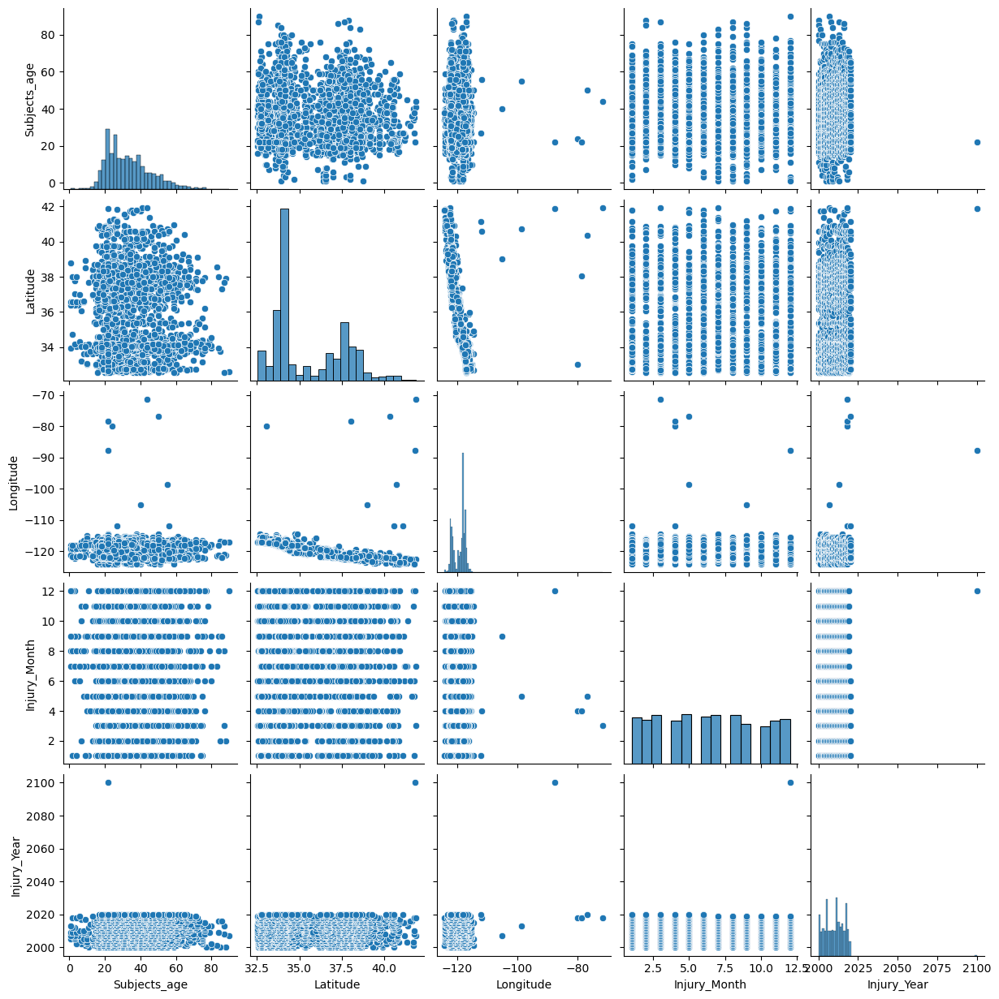

In [24]:
# reset the index to remove any duplicate labels
ca_df.reset_index(drop=True, inplace=True)

# create a pair plot
sns.pairplot(ca_df)
plt.show()

#### Box Plots

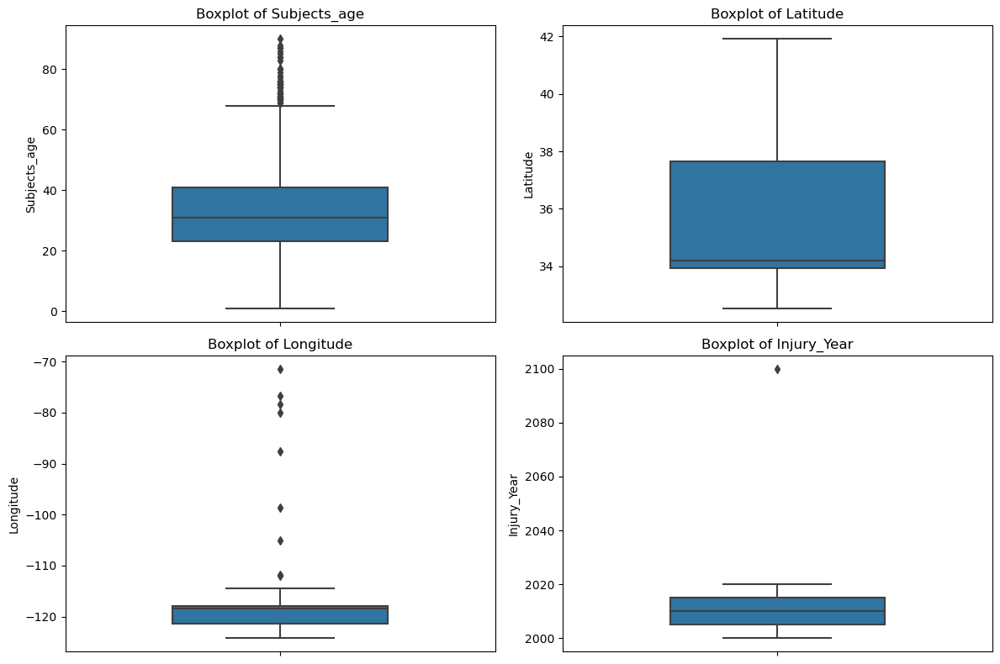

In [25]:
# List of numerical predictors
predictors = ['Subjects_age', 'Latitude', 'Longitude', 'Injury_Year']

# create boxplots 
plt.figure(figsize=(12, 8))  

for i, predictor in enumerate(predictors):
    plt.subplot(2, 2, i + 1)  
    sns.boxplot(data=ca_df, y=predictor, width=0.5)
    plt.title(f'Boxplot of {predictor}')
    plt.ylabel(predictor)

plt.tight_layout()  
plt.show()

The column 'Injury_Year' appears to have an outlier, the column will be reflected to only show data collected form 2000-2020. 

#### Bar Plots

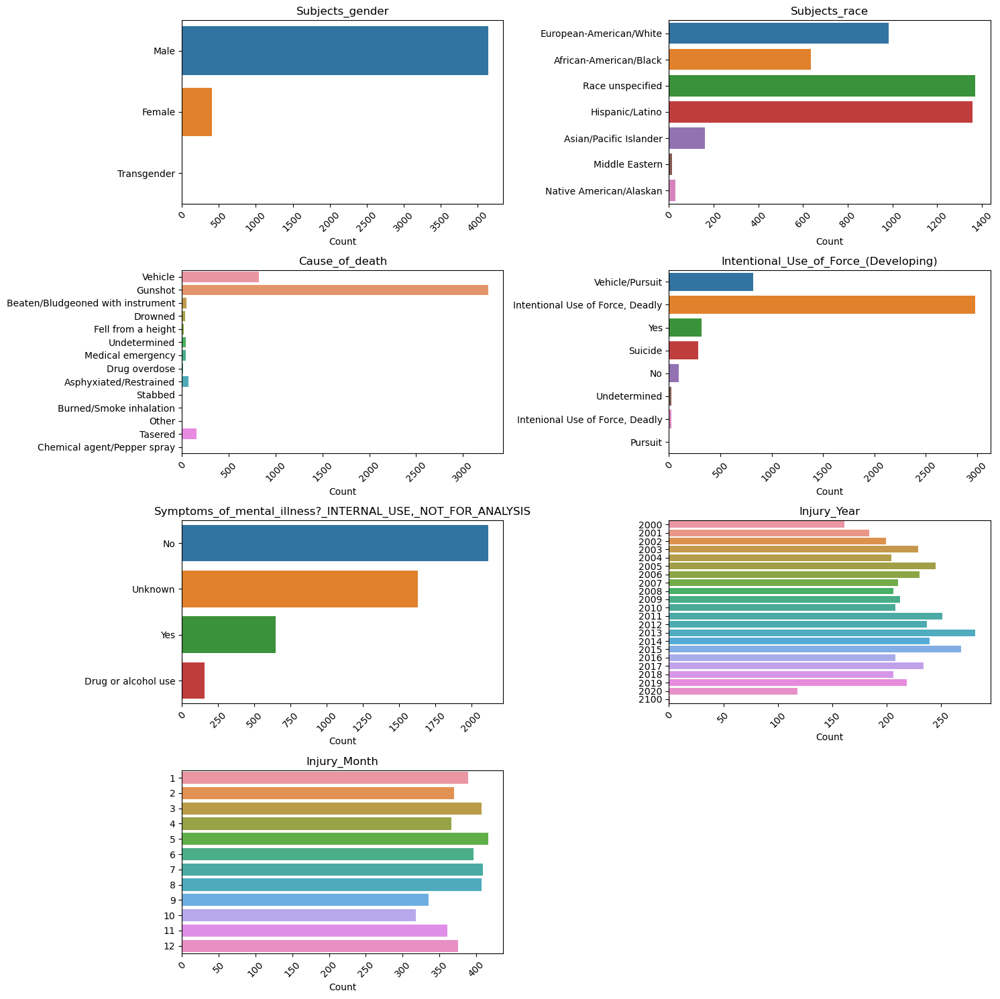

In [26]:
# list of selected columnsfor bar plot 
selected_columns =['Subjects_gender', 'Subjects_race', 'Cause_of_death', 'Intentional_Use_of_Force_(Developing)',
                   'Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS', 'Injury_Year', 'Injury_Month']

# calculate the number of rows and columns for the subplot grid
num_cols = 2
num_rows = (len(selected_columns) - 1) // num_cols + 1

# create subplots and flatten axis
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15))
axes = axes.flatten()

# iterate through selected columns and create horizontal countplots
for i, column in enumerate(selected_columns):
    sns.countplot(data=ca_df, y=column, ax=axes[i])
    axes[i].tick_params(axis='x', rotation=45)  

    axes[i].set_title(f'{column}')
    axes[i].set_xlabel('Count')
    axes[i].set_ylabel('')

# remove empty subplots
for i in range(len(selected_columns), num_rows * num_cols):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()

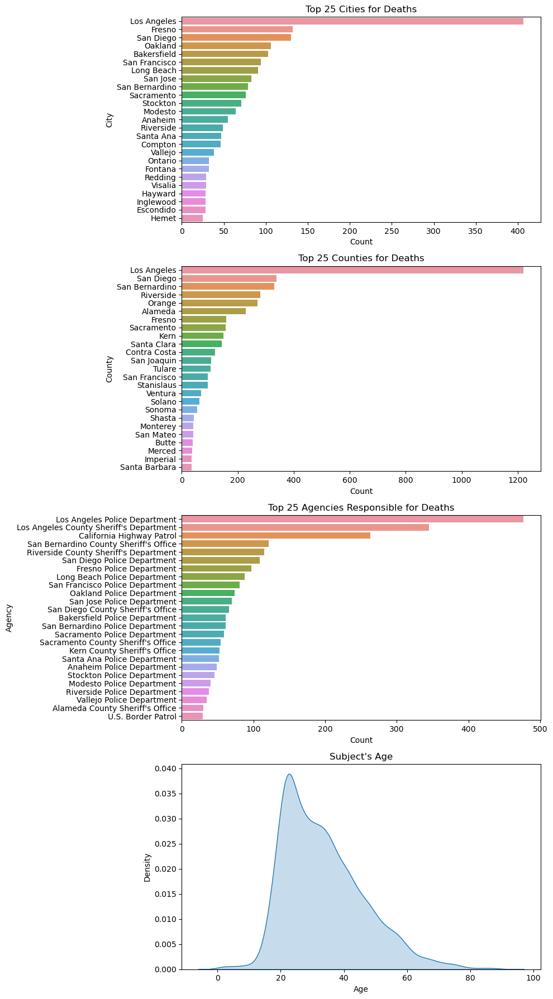

In [27]:
# create figure with subplots
fig, axes = plt.subplots(4, 1, figsize=(10, 18))

# first suplot - top 25 cities for deaths 
sns.countplot(data=ca_df, y='Location_of_death_(city)', 
              order=ca_df['Location_of_death_(city)'].value_counts().index[:25], ax=axes[0])
axes[0].set_xlabel('Count')
axes[0].set_ylabel('City')
axes[0].set_title('Top 25 Cities for Deaths')


# second subplot - top 25 counties for deaths 
sns.countplot(data=ca_df, y='Location_of_death_(county)', 
              order=ca_df['Location_of_death_(county)'].value_counts().index[:25], ax=axes[1])
axes[1].set_xlabel('Count')
axes[1].set_ylabel('County')
axes[1].set_title('Top 25 Counties for Deaths')

# third suplot - top 25 agencies responsible for deaths 
sns.countplot(data=ca_df, y='Agency_responsible_for_death', 
              order=ca_df['Agency_responsible_for_death'].value_counts().index[:25], ax=axes[2])
axes[2].set_xlabel('Count')
axes[2].set_ylabel('Agency')
axes[2].set_title('Top 25 Agencies Responsible for Deaths')


# fourth suplot - subjects age 
sns.kdeplot(data=ca_df, x='Subjects_age', fill=True, ax=axes[3])
axes[3].set_xlabel('Age')
axes[3].set_ylabel('Density')
axes[3].set_title('Subject\'s Age')


# Adjust subplot spacing
plt.tight_layout()

# Show the combined plot
plt.show()

#### Line Plot (Trend of Deaths)

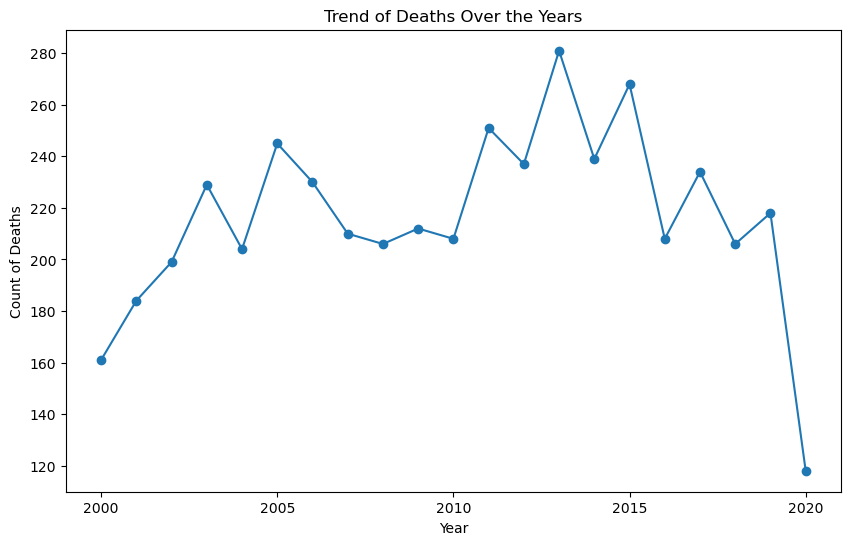

In [28]:
# per boxplot, the years will be filtered to 2000-2020 
ca_df = ca_df[(ca_df['Injury_Year'] >= 2000) & (ca_df['Injury_Year'] <= 2020)]

yearly_deaths = ca_df['Injury_Year'].value_counts().sort_index()

# create a line plot for the trend
plt.figure(figsize=(10, 6))
plt.plot(yearly_deaths.index, yearly_deaths.values, marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Count of Deaths')
plt.title('Trend of Deaths Over the Years')

# set x-axis ticks to display every 5 years from 2000 to 2020
plt.xticks(range(2000, 2021, 5))


plt.grid(False)
plt.show()

### Removing Outliers 

In [29]:
# removing outliers from 'longitude' and 'latitude' 

# calculate the interquartile range (IQR) for latitude and longitude to remove outliers 
Q1_latitude = ca_df['Latitude'].quantile(0.25)
Q3_latitude = ca_df['Latitude'].quantile(0.75)
IQR_latitude = Q3_latitude - Q1_latitude

Q1_longitude = ca_df['Longitude'].quantile(0.25)
Q3_longitude = ca_df['Longitude'].quantile(0.75)
IQR_longitude = Q3_longitude - Q1_longitude

# define the lower and upper bounds using IQR
latitude_lower_bound = Q1_latitude - 1.5 * IQR_latitude
latitude_upper_bound = Q3_latitude + 1.5 * IQR_latitude

longitude_lower_bound = Q1_longitude - 1.5 * IQR_longitude
longitude_upper_bound = Q3_longitude + 1.5 * IQR_longitude

# filter df based on IQR
filtered_df = ca_df[
    (ca_df['Latitude'] >= latitude_lower_bound) &
    (ca_df['Latitude'] <= latitude_upper_bound) &
    (ca_df['Longitude'] >= longitude_lower_bound) &
    (ca_df['Longitude'] <= longitude_upper_bound)
]

In [30]:
# removing outliers from 'subjects_age'
ca_df['Subjects_age'].unique()

array([17., 24., 31., 28., 41., 25., 26., 22., 35., 20., 88., 40., 85.,
       42., 50., 43., 27., 29., 46., 59., 51., 36., 18., 23., 38., 44.,
       34., 33., 39., 30., 37., 45., 16., 47., 53., 55., 54., 19., 80.,
       11., 32., 52., 48., 21., 77., 14., 66., 15., 60., 56., 58., 83.,
        9., 65., 57.,  7., 62., 10., 49.,  4., 75., 67., 63., 69., 74.,
       70., 68., 61., 13.,  8.,  1., 72.,  3., 71., 64.,  5., 90., 87.,
       76.,  2., 79., 84.,  6., 78., 12., 86., 73.])

In [31]:
# calculate the interquartile range (IQR) for latitude and longitude to remove outliers 
Q1_latitude = ca_df['Subjects_age'].quantile(0.25)
Q3_latitude = ca_df['Subjects_age'].quantile(0.75)
IQR_latitude = Q3_latitude - Q1_latitude


# define the lower and upper bounds using IQR
latitude_lower_bound = Q1_latitude - 1.5 * IQR_latitude
latitude_upper_bound = Q3_latitude + 1.5 * IQR_latitude

# filter df based on IQR
filtered_df = ca_df[
    (ca_df['Subjects_age'] >= latitude_lower_bound) &
    (ca_df['Subjects_age'] <= latitude_upper_bound)] 

### Contigency Tables

In [32]:
# define target column 
target_column = 'Cause_of_death'

# create an empty array to store the results
chi2_results = []

# iterate through all columns (without the target column)
for column in ca_df.columns:
    if column != target_column:
        cross_tab = pd.crosstab(index=ca_df[column], columns=ca_df[target_column])
        chi2, p, dof, expected = chi2_contingency(cross_tab)
        chi2_results.append({
            'Variable': column,
            'Chi-Square Value': chi2,
            'P-Value': p,
            'Degrees of Freedom': dof
        })

# display results 
chi2_df = pd.DataFrame(chi2_results)
chi2_df

,Variable,Chi-Square Value,P-Value,Degrees of Freedom
0,Unique_ID,59124.000000,4.841482e-01,59111
1,Subjects_age,1710.108426,1.275170e-27,1118
2,Subjects_gender,499.696272,4.030832e-89,26
3,Subjects_race,191.762870,1.449316e-11,78
4,Location_of_injury_(address),55884.447874,4.379805e-02,55315
5,Location_of_death_(city),10834.579335,1.137971e-32,9139
6,Location_of_death_(county),1283.730930,1.245392e-36,702
7,Latitude,57265.138598,4.869947e-08,55471
8,Longitude,57265.138598,3.929518e-08,55458
9,Agency_responsible_for_death,9231.163126,2.482851e-39,7514


In [33]:
# define target column 
target_column = 'Intentional_Use_of_Force_(Developing)'

# create an empty array to store the results
chi2_results = []

# iterate through all columns (without the target column)
for column in ca_df.columns:
    if column != target_column:
        cross_tab = pd.crosstab(index=ca_df[column], columns=ca_df[target_column])
        chi2, p, dof, expected = chi2_contingency(cross_tab)
        chi2_results.append({
            'Variable': column,
            'Chi-Square Value': chi2,
            'P-Value': p,
            'Degrees of Freedom': dof
        })

# display results 
chi2_df = pd.DataFrame(chi2_results)
chi2_df

,Variable,Chi-Square Value,P-Value,Degrees of Freedom
0,Unique_ID,31836.000000,4.878803e-01,31829
1,Subjects_age,973.562079,5.252351e-20,602
2,Subjects_gender,434.081105,8.213261e-84,14
3,Subjects_race,342.647123,8.687141e-49,42
4,Location_of_injury_(address),30890.816069,3.757128e-06,29785
5,Location_of_death_(city),7257.715397,1.040673e-94,4921
6,Location_of_death_(county),615.277636,1.318081e-13,378
7,Latitude,31376.689052,6.376562e-10,29869
8,Longitude,31376.689052,5.340616e-10,29862
9,Agency_responsible_for_death,7248.872701,7.372474e-186,4046


In [34]:
# create contigency table for 'Intentional_Use_of_Force_(Developing)' and 'Cause_of_death'
contingency_force = pd.crosstab(ca_df['Intentional_Use_of_Force_(Developing)'], ca_df ['Cause_of_death'])

contingency_force

Cause_of_death,Asphyxiated/Restrained,Beaten/Bludgeoned with instrument,Burned/Smoke inhalation,Chemical agent/Pepper spray,Drowned,Drug overdose,Fell from a height,Gunshot,Medical emergency,Other,Stabbed,Tasered,Undetermined,Vehicle
Intentional_Use_of_Force_(Developing),,,,,,,,,,,,,,
"Intenional Use of Force, Deadly",0,0,0,0,0,0,0,21,0,0,0,0,0,0
"Intentional Use of Force, Deadly",0,0,0,0,0,0,0,2977,0,1,1,0,0,0
No,0,1,0,0,35,12,13,0,29,0,2,0,3,0
Pursuit,0,0,0,0,0,0,0,0,0,0,0,0,0,4
Suicide,1,0,1,0,1,1,7,269,0,1,2,2,0,1
Undetermined,0,0,0,0,0,1,0,0,1,0,0,0,23,0
Vehicle/Pursuit,0,0,0,0,0,0,0,0,0,0,0,0,0,820
Yes,72,49,4,7,0,0,1,0,12,4,0,155,14,0


In [35]:
# create contigency table for 'Intentional_Use_of_Force_(Developing)' and 'Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS'
contingency_disposition = pd.crosstab(ca_df['Intentional_Use_of_Force_(Developing)'], ca_df['Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS'])

contingency_disposition

"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Accidental,Administrative discipline,Administrative discipline/Civil suit/Family awarded money,Civil suit/Family awarded money,Civil suit/Pending,Civil suit/Results unreported,Cleared,Criminal,Criminal/Off-duty,Drug overdose,...,Pending investigation,Possible suicide,Possibly suicide,Ruled accidental,Ruled suicide,Ruled suicide by police,Suicide,Unknown,Unreported,Use of force justified
Intentional_Use_of_Force_(Developing),,,,,,,,,,,,,,,,,,,,,
"Intenional Use of Force, Deadly",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,2,19,0
"Intentional Use of Force, Deadly",2,2,2,6,1,0,53,19,1,0,...,740,1,1,0,0,1,0,162,1252,3
No,9,1,0,0,0,0,7,1,0,0,...,12,0,0,1,0,0,0,6,53,2
Pursuit,0,0,0,0,0,0,0,0,0,0,...,2,0,0,0,0,0,0,0,2,0
Suicide,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,67,0,219,0,0,0
Undetermined,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,1,23,0
Vehicle/Pursuit,8,1,0,1,0,1,31,62,0,0,...,88,0,0,1,0,0,0,53,565,0
Yes,12,0,0,1,1,1,57,2,0,1,...,61,0,0,1,0,0,0,13,134,0


In [36]:
# create contigency table for 'Cause_of_death' and 'Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS'
contingency_death = pd.crosstab(ca_df['Cause_of_death'], ca_df['Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS'])

contingency_death

"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Accidental,Administrative discipline,Administrative discipline/Civil suit/Family awarded money,Civil suit/Family awarded money,Civil suit/Pending,Civil suit/Results unreported,Cleared,Criminal,Criminal/Off-duty,Drug overdose,...,Pending investigation,Possible suicide,Possibly suicide,Ruled accidental,Ruled suicide,Ruled suicide by police,Suicide,Unknown,Unreported,Use of force justified
Cause_of_death,,,,,,,,,,,,,,,,,,,,,
Asphyxiated/Restrained,4,0,0,0,0,0,17,0,0,0,...,15,0,0,0,0,0,1,4,26,0
Beaten/Bludgeoned with instrument,2,0,0,0,0,1,7,1,0,0,...,9,0,0,0,0,0,0,5,17,0
Burned/Smoke inhalation,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,1,0,3,0
Chemical agent/Pepper spray,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,5,0
Drowned,3,0,0,0,0,0,0,0,0,0,...,6,0,0,0,0,0,1,3,23,0
Drug overdose,4,1,0,0,0,0,2,0,0,0,...,0,0,0,0,0,0,1,1,4,0
Fell from a height,1,0,0,0,0,0,1,0,0,0,...,1,0,0,0,2,0,5,2,9,0
Gunshot,2,2,2,5,1,0,53,19,1,0,...,740,1,1,0,64,1,205,163,1271,3
Medical emergency,1,0,0,0,0,0,3,0,0,0,...,11,0,0,1,0,0,0,0,21,2


### ANOVA (Cause of Death and Numerical Values)

In [37]:
# ANOVA between numberical variables and Cause of Death 

for predictor in ['Subjects_age', 'Latitude', 'Longitude', 'Injury_Year']:
    grouped_data = [ca_df[predictor][ca_df['Cause_of_death'] == category] for category in ca_df['Cause_of_death'].unique()]
    f_statistic, p_value = stats.f_oneway(*grouped_data)
    print(f'{predictor} vs. Cause of Death:')
    print(f'F-statistic: {f_statistic}')
    print(f'P-value: {p_value}\n')

Subjects_age vs. Cause of Death:
F-statistic: 5.728529438692074
P-value: 1.4891504337475343e-10

Latitude vs. Cause of Death:
F-statistic: 3.7049401522931693
P-value: 6.624725458629456e-06

Longitude vs. Cause of Death:
F-statistic: 2.0464365900729953
P-value: 0.014292850594702793

Injury_Year vs. Cause of Death:
F-statistic: 5.123165376161279
P-value: 3.993013836667257e-09



### Text Analysis (brief description column)

In [38]:
corpus = ca_df['A_brief_description_of_the_circumstances_surrounding_the_death']

corpus.tail()

4543    Reports of a robbery at C.V. Guns & Tackle cam...
4544    About 1 a.m., deputies responded to a burglary...
4545    Around 9:30 a.m., deputies responded to a susp...
4546    Border Patrol agents briefly chased the car be...
4547    Louis Lane showed up at theWalmart distributio...
Name: A_brief_description_of_the_circumstances_surrounding_the_death, dtype: object

In [39]:
corpus.sample(20)

2200    After a brief pursuit of the suspect's minivan...
2609    Police got a report of a man who was seen foll...
602     Brice Everett Ross, 27, died after being shot ...
1256    Guillermo Davila, who suffered from Alzheimer'...
258     Stelley's girlfriend called SFPD from the Metr...
1508    Mario Alberto Garay became unresponsive while ...
4174    Jacob Rodriguez, 23, was allegedly driving on ...
2389    Deputy Mike Blue shot Adam Hortter when he fou...
63      Ochoa had locked himself in the bathroom, scre...
4485    A 19-year-old man crashed a car while fleeing ...
1283    Victor Ernesto Estrada reportedly killed himse...
3999    Police responded to a domestic violence incide...
213     Ethel McClay was killed after a driver fleeing...
1006    LAPD officer Steven Garcia shot Devin Brown 7 ...
2852    Police received calls that a man was driving e...
1609    Jennifer Fries entered the City Market Pharmac...
287     Officer George Tamayo shot Robert Lee Jones Jr...
796     Robbin

In [40]:
corpus.describe()

count                                                  4548
unique                                                 4338
top       A car stolen at knifepoint and doing 80 MPH on...
freq                                                      8
Name: A_brief_description_of_the_circumstances_surrounding_the_death, dtype: object

In [41]:
# tfidfVectorizer
vectorizer = TfidfVectorizer()

# apply vectorizer tp corpus
spmat = vectorizer.fit_transform(corpus)

In [42]:
# create new df 'X'
X = pd.DataFrame.sparse.from_spmatrix(spmat)

In [43]:
labels = ca_df['Cause_of_death']

# subset labels that have text data present
text_subset = labels.loc[corpus.index]

text_subset

0                                 Vehicle
1                                 Vehicle
2                                 Gunshot
3       Beaten/Bludgeoned with instrument
4                                 Gunshot
                      ...                
4543                              Gunshot
4544                              Gunshot
4545                              Gunshot
4546                              Vehicle
4547                              Gunshot
Name: Cause_of_death, Length: 4548, dtype: object

In [44]:
# split the data
X_train, X_test, y_train, y_test = train_test_split(X, text_subset,
                                                    test_size=0.50)

In [45]:
# feature selection
X_new = SelectKBest(score_func=f_classif, k=10)

# fit selector on training data
X_new.fit(X_train, y_train)

# transform training and test data
X_train_selected = X_new.transform(X_train)
X_test_selected = X_new.transform(X_test)

In [46]:
print('Top 10 features %s' % X_train.columns[X_new.get_support()].tolist())

Top 10 features [324, 1267, 1465, 2125, 2413, 3038, 3608, 7722, 8365, 9077]


In [47]:
# retrieve feature names
feature_names = vectorizer.get_feature_names_out()
selected_indices = X_new.get_support(indices=True)

# Top 10 selected words
print('Top 10 selected words:', [feature_names[i] for i in selected_indices])

Top 10 selected words: ['addled', 'bogus', 'bucholz', 'collier', 'crawl', 'drowned', 'fine', 'reymer', 'shot', 'tasered']


The 'A_brief_description_of_the_circumstances_surrounding_the_death' was deemed to be irrelevant and will be dropped from the df. 

In [48]:
ca_df.drop(columns=['A_brief_description_of_the_circumstances_surrounding_the_death'])

,Unique_ID,Subjects_age,Subjects_gender,Subjects_race,Location_of_injury_(address),Location_of_death_(city),Location_of_death_(county),Latitude,Longitude,Agency_responsible_for_death,Cause_of_death,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Intentional_Use_of_Force_(Developing),"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Injury_Month,Injury_Year
0,25746,17.0,Male,European-American/White,27898-27804 US-101,Willits,Mendocino,39.470883,-123.361751,Mendocino County Sheriff's Office,Vehicle,Unreported,Vehicle/Pursuit,No,1,2000
1,1,24.0,Female,African-American/Black,5700 block Mack Road,Sacramento,Sacramento,38.473949,-121.433776,Sacramento Police Department,Vehicle,Unknown,Vehicle/Pursuit,No,1,2000
2,8,31.0,Male,Race unspecified,3400 block Gray Street,Muscoy,San Bernardino,34.157941,-117.361652,"San Bernardino Police Department, San Bernardi...",Gunshot,Unreported,"Intentional Use of Force, Deadly",Unknown,1,2000
3,10,28.0,Male,Race unspecified,9600 block Cheddar Street,Downey,Los Angeles,33.915678,-118.125081,Downey Police Department,Beaten/Bludgeoned with instrument,Unreported,Yes,Unknown,1,2000
4,13,24.0,Male,Race unspecified,23600 block Suncrest Avenue,Moreno Valley,Riverside,33.925080,-117.249796,Riverside County Sheriff's Department,Gunshot,Unreported,"Intentional Use of Force, Deadly",Unknown,1,2000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4543,28294,22.0,Male,Race unspecified,41945 Boardwalk,Palm Desert,Riverside,33.744249,-116.355569,Riverside County Sheriff's Department,Gunshot,Pending investigation,"Intentional Use of Force, Deadly",No,6,2020
4544,28301,22.0,Female,Asian/Pacific Islander,22000 block Loumont Drive,Lake Forest,Orange,33.630776,-117.699253,Orange County Sheriff's Office,Gunshot,Pending investigation,"Intentional Use of Force, Deadly",Unknown,6,2020
4545,28309,31.0,Male,African-American/Black,"CA-210, west of I-215",San Bernardino,Los Angeles,34.139447,-117.325317,San Bernardino County Sheriff's Office,Gunshot,Pending investigation,"Intentional Use of Force, Deadly",No,6,2020
4546,28310,65.0,Female,Hispanic/Latino,1200 block East Avenue S,Palmdale,Los Angeles,34.557522,-118.106008,Los Angeles County Sheriff's Department,Vehicle,Pending investigation,Pursuit,No,6,2020


## Data Pre-Processing

In [49]:
ca_df['Intentional_Use_of_Force_(Developing)'].unique()

array(['Vehicle/Pursuit', 'Intentional Use of Force, Deadly', 'Yes',
       'Suicide', 'No', 'Undetermined', 'Intenional Use of Force, Deadly',
       'Pursuit'], dtype=object)

In [50]:
# map values into two actegories intentional use of force and non-intentional

# define the mapping of values to categories
mapping = {
    'Vehicle/Pursuit': 'Nonintentional',
    'Intentional Use of Force, Deadly': 'Intentional Use of Force, Deadly',
    'Yes': 'Intentional Use of Force, Deadly',
    'Suicide': 'Nonintentional',
    'No': 'Nonintentional',
    'Undetermined': 'Nonintentional',
    'Intenional Use of Force, Deadly': 'Intentional Use of Force, Deadly', 
    'Pursuit': 'Nonintentional', 
}

# replace values based on the mapping
force_df = ca_df['Intentional_Use_of_Force_(Developing)'].map(mapping)

# verify the result
force_df.unique()

array(['Nonintentional', 'Intentional Use of Force, Deadly'], dtype=object)

### Encoding Data

In [51]:
filtered_encoded_df = ca_df.copy()

# identify categorical columns
categorical_columns = categorical_columns = ['Subjects_gender', 'Subjects_race', 'Location_of_injury_(address)', 
                                             'Location_of_death_(city)', 'Location_of_death_(county)', 
                                             'Agency_responsible_for_death','Cause_of_death', 
                                             'A_brief_description_of_the_circumstances_surrounding_the_death', 
                                             'Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS',  
                                             'Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS'
]

# create df for categorical features
cat_df = filtered_encoded_df[categorical_columns]


# one-hot encoding with handle_unknown='ignore'
encoder = OneHotEncoder(handle_unknown='ignore', sparse=False)
encoded_cat = encoder.fit_transform(cat_df)

# get the feature names after encoding
feature_names = encoder.get_feature_names_out(input_features=categorical_columns)

# fill missing values in the encoded DataFrame
encoded_df = pd.DataFrame(encoded_cat, columns=feature_names)
encoded_df.fillna(0, inplace=True) 

# concatenate the original df and df with encoded features
# drop the categorical columns from ca_df
ca_df = ca_df.drop(columns=categorical_columns)
encoded_df = pd.concat([ca_df, encoded_df], axis=1)

In [52]:
encoded_df.sample(10)

,Unique_ID,Subjects_age,Latitude,Longitude,Intentional_Use_of_Force_(Developing),Injury_Month,Injury_Year,Subjects_gender_Female,Subjects_gender_Male,Subjects_gender_Transgender,...,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Ruled suicide","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Ruled suicide by police","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Suicide","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unknown","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unreported","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Use of force justified","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Drug or alcohol use","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_No","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unknown","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Yes"
3964,23010,18.0,37.362167,-120.613924,"Intentional Use of Force, Deadly",10,2017,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4176,25030,30.0,34.097159,-118.328511,"Intentional Use of Force, Deadly",10,2018,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3976,23342,7.0,34.023967,-118.192318,Vehicle/Pursuit,11,2017,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1705,6985,33.0,33.787525,-118.247855,"Intentional Use of Force, Deadly",3,2008,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
412,1622,10.0,33.931561,-118.122770,Vehicle/Pursuit,4,2002,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
903,27417,47.0,32.794960,-116.971038,Vehicle/Pursuit,8,2004,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2571,11072,45.0,33.767745,-118.198744,"Intentional Use of Force, Deadly",2,2012,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
4243,25606,43.0,38.273598,-122.345617,"Intentional Use of Force, Deadly",2,2019,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
750,2940,22.0,34.028056,-118.219390,Vehicle/Pursuit,11,2003,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
2137,9060,44.0,33.814929,-117.826991,Suicide,4,2010,0.0,1.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


In [53]:
encoded_df.isna().sum()

Unique_ID                                                                         0
Subjects_age                                                                      0
Latitude                                                                          0
Longitude                                                                         0
Intentional_Use_of_Force_(Developing)                                             0
                                                                                 ..
Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Use of force justified     0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Drug or alcohol use    0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_No                     0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unknown                0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Yes                    0
Length: 10001, dtype: int64

In [54]:
encoded_df.shape

(4548, 10001)

### Data Splitting

In [55]:
# create a copy of df
ca_df = encoded_df.copy()

In [56]:
# split the dataset to predict whether death was intentional 
X = ca_df.drop('Intentional_Use_of_Force_(Developing)', axis=1)
y = force_df #Intentional_Use_of_Force_(Developing)is stored in its own df 

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=42)

# scale the train & test set
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


# print the dimensions of X_train_pca and X_test_pca
print("Dimensions of X_train_pca:", X_train_scaled.shape)
print("Dimensions of X_test_pca:", X_test_scaled.shape)

Dimensions of X_train_pca: (2728, 10000)
Dimensions of X_test_pca: (1820, 10000)
